
### Fine-tuning YOLOv5 model on MOT17 Dataset for pedestrain detector

### Importing required libraries

In [ ]:
import os
import cv2
import shutil
import random
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

### Downloading the MOT17 dataset from Kaggle via Kaggle API

In [ ]:
# Install Kaggle API
!pip install -q kaggle

# Upload kaggle.json key manually
from google.colab import files
files.upload()

# Move key to the correct location and secure it
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d wenhoujinjust/mot-17

Saving kaggle.json to kaggle.json
Dataset URL: https://www.kaggle.com/datasets/wenhoujinjust/mot-17
License(s): MIT
100% 5.45G/5.46G [04:00<00:00, 47.8MB/s]
100% 5.46G/5.46G [04:00<00:00, 24.4MB/s]


In [ ]:
# Delete kaggle.json after use for safety
os.remove("/content/kaggle.json")

In [ ]:
!unzip mot-17.zip

Streaming output truncated to the last 5000 lines.
  inflating: MOT17/train/MOT17-10-SDP/img1/000624.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000625.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000626.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000627.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000628.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000629.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000630.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000631.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000632.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000633.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000634.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000635.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000636.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000637.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000638.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000639.jpg  
  inflating: MOT17/train/MOT17-10-SDP/img1/000640.jpg

### Dataset path

In [ ]:
mot17_path = '/content/MOT17'
train_path = os.path.join(mot17_path, 'train')
test_path  = os.path.join(mot17_path, 'test' )

### Mount google drive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
mydrive = '/content/drive/MyDrive'

### Output paths


In [ ]:
output_path  = '/content/drive/MyDrive/mot17_yolo'  # directory to store images, labels in YOLO format

In [ ]:
train_images = '/content/drive/MyDrive/mot17_yolo/train/images'
train_labels = '/content/drive/MyDrive/mot17_yolo/train/labels'

os.makedirs(train_images, exist_ok=True)
os.makedirs(train_labels, exist_ok=True)

In [ ]:
val_images = '/content/drive/MyDrive/mot17_yolo/val/images'
val_labels = '/content/drive/MyDrive/mot17_yolo/val/labels'

os.makedirs(val_images, exist_ok=True)
os.makedirs(val_labels, exist_ok=True)

In [ ]:
test_images = '/content/drive/MyDrive/mot17_yolo/test/images'
os.makedirs(test_images, exist_ok=True)

### Converting MOT17 Annotations to YOLO Format

In [ ]:
def mot17_to_yolo(train_path, train_images, train_labels, min_confidence=0.0, min_visibility=0.0):

    # Create output directories if they don't exist
    os.makedirs(train_images, exist_ok=True)
    os.makedirs(train_labels, exist_ok=True)

    # List all sequences that are directories and contain '-FRCNN' (example: MOT17-02-FRCNN)
    seqs = sorted([
        seq for seq in os.listdir(train_path)
        if os.path.isdir(os.path.join(train_path, seq)) and '-FRCNN' in seq
    ])

    # Iterate over each sequence
    for seq in seqs:
        img_dir = os.path.join(train_path, seq, 'img1')      # Image directory
        gt_file = os.path.join(train_path, seq, 'gt/gt.txt') # Ground truth annotation file

        if not os.path.exists(gt_file):
            print(f"Skipping {seq}, gt.txt not found")
            continue

        print(f"Processing sequence: {seq}")

        # Read all lines from ground truth file
        with open(gt_file, 'r') as f:
            lines = f.readlines()

        frame_to_boxes = {}  # Dictionary to store YOLO-formatted boxes per image
        img_dims = {}        # Cache image dimensions to avoid multiple disk reads

        # Parse each annotation line
        for line in lines:
            parts = line.strip().split(',')
            if len(parts) < 9:
                continue  # Skip malformed lines

            frame_id, obj_id, x, y, w, h, conf, cls_id, vis = parts[:9]

            if int(cls_id) != 1:
                continue  # Skip non-pedestrian classes (pedestrian class = 1)

            if float(conf) < min_confidence or float(vis) < min_visibility:
                continue  # Skip low-confidence or low-visibility annotations

            img_filename = f"{int(frame_id):06d}.jpg"
            src_img = os.path.join(img_dir, img_filename)

            if not os.path.exists(src_img):
                continue  # Skip missing images

            # Read and cache image dimensions
            if src_img not in img_dims:
                img = cv2.imread(src_img)
                if img is None:
                    continue
                ih, iw = img.shape[:2]
                img_dims[src_img] = (iw, ih)
            else:
                iw, ih = img_dims[src_img]

            # Convert bounding box to YOLO format (x_center, y_center, width, height normalized)
            x, y, w, h = float(x), float(y), float(w), float(h)
            xc = (x + w / 2) / iw
            yc = (y + h / 2) / ih
            wn = w / iw
            hn = h / ih

            # Clip values to [0, 1] to avoid any numerical issues
            xc = max(0.0, min(1.0, xc))
            yc = max(0.0, min(1.0, yc))
            wn = max(0.0, min(1.0, wn))
            hn = max(0.0, min(1.0, hn))

            if wn <= 0 or hn <= 0:
                continue  # Skip degenerate boxes

            key = (seq, img_filename)
            if key not in frame_to_boxes:
                frame_to_boxes[key] = []

            # Class 0 is assumed for pedestrian (YOLO format: class x_center y_center width height)
            frame_to_boxes[key].append(f"0 {xc:.6f} {yc:.6f} {wn:.6f} {hn:.6f}")

        # Write out images and corresponding YOLO labels
        for (seq, img_filename), labels in frame_to_boxes.items():
            src_img = os.path.join(img_dir, img_filename)
            dst_img = os.path.join(train_images, f"{seq}_{img_filename}")
            dst_label = os.path.join(train_labels, f"{seq}_{img_filename.replace('.jpg', '.txt')}")

            # Copy the image if not already copied
            if not os.path.exists(dst_img):
                shutil.copy(src_img, dst_img)

            # Write the label file in YOLO format
            with open(dst_label, 'w') as f:
                f.write('\n'.join(labels) + '\n')

In [ ]:
mot17_to_yolo(train_path, train_images, train_labels)

Processing sequence: MOT17-02-FRCNN
Processing sequence: MOT17-04-FRCNN
Processing sequence: MOT17-05-FRCNN
Processing sequence: MOT17-09-FRCNN
Processing sequence: MOT17-10-FRCNN
Processing sequence: MOT17-11-FRCNN
Processing sequence: MOT17-13-FRCNN


#### Split the `train` data into `train + val` data(80/20 randomly)

In [ ]:
# Paths
train_images = '/content/drive/MyDrive/mot17_yolo/train/images'
train_labels = '/content/drive/MyDrive/mot17_yolo/train/labels'
val_images   = '/content/drive/MyDrive/mot17_yolo/val/images'
val_labels   = '/content/drive/MyDrive/mot17_yolo/val/labels'

# Ensure val directories exist
os.makedirs(val_images, exist_ok=True)
os.makedirs(val_labels, exist_ok=True)

# Load and shuffle all training images
all_images = glob(train_images + '/*.jpg')
random.shuffle(all_images)

# 80-20 split
split_idx = int(0.8 * len(all_images))
images_train = all_images[:split_idx]
images_valid = all_images[split_idx:]

# Move val images + labels
for image_path in images_valid:
    img_name = os.path.basename(image_path)
    label_name = img_name.replace('.jpg', '.txt')

    src_label = os.path.join(train_labels, label_name)
    dst_img   = os.path.join(val_images, img_name)
    dst_label = os.path.join(val_labels, label_name)

    shutil.move(image_path, dst_img)

    if os.path.exists(src_label):
        shutil.move(src_label, dst_label)
    else:
        print(f"Warning: Label file missing for {img_name}")

##### Copying test images from `MOT17/test` folder (specifically the -FRCNN sequences) into `mot17_yolo/test/images` folder


* Usually, for test sets in MOT17, ground truth labels are not publicly available (since it’s used for leaderboard evaluation), so no labels for MOT17 test set, which is normal for real test sets

In [ ]:
mot17_path = os.path.join(mydrive,    'MOT17')
train_path = os.path.join(mot17_path, 'train')
test_path  = os.path.join(mot17_path, 'test' )

# List all -FRCNN test sequences
seqs = sorted([
    seq for seq in os.listdir(test_path)
    if os.path.isdir(os.path.join(test_path, seq)) and '-FRCNN' in seq
])

test_images = '/content/drive/MyDrive/mot17_yolo/test/images'
os.makedirs(test_images, exist_ok=True)


for seq in seqs:
    img_dir = os.path.join(test_path, seq, 'img1')  # Path to image frames
    img_files = sorted(os.listdir(img_dir))         # List all image files

    for img_filename in img_files:
        if not img_filename.endswith('.jpg'):
            continue

        src_img = os.path.join(img_dir, img_filename)
        dst_img = os.path.join(test_images, f"{seq}_{img_filename}")  # Prefix with seq name

        if not os.path.exists(dst_img):
            shutil.copy(src_img, dst_img)

####  Creating `data.yaml` for YOLOv5 Training

```yaml
train: /content/drive/MyDrive/mot17_yolo/train/images
val  : /content/drive/MyDrive/mot17_yolo/val/images
test : /content/drive/MyDrive/mot17_yolo/test/images

nc: 1
names: ['pedestrian']
```

In [ ]:
data_yaml_path = '/content/drive/MyDrive/mot17_yolo/data.yaml'

with open(data_yaml_path, 'w') as f:
    f.write(f"""
train: {train_images}
val: {val_images}
test: {test_images}

nc: 1
names: ['pedestrian']
""")

print("data.yaml created at:", data_yaml_path)

data.yaml created at: /content/drive/MyDrive/mot17_yolo/data.yaml


The dataset is structured in the following manner:

```
mot17_yolo/
├── data.yaml
├── train/
│   ├── images/
│   │   ├── MOT17-02-FRCNN_000001.jpg
│   │   ├── ...
│   └── labels/
│       ├── MOT17-02-FRCNN_000001.txt
│       ├── ...
├── val/
│   ├── images/
│   │   ├── MOT17-05-FRCNN_000001.jpg
│   │   ├── ...
│   └── labels/
│       ├── MOT17-05-FRCNN_000001.txt
│       ├── ...
└── test/
      └── images/
          ├── MOT17-01-FRCNN_000001.jpg
          ├── ...


```

### Helper Functions for Logging



In [ ]:
TRAIN = True

In [ ]:
def set_res_dir():

    base_path = '/content/drive/MyDrive/mot17_yolo/results_train'
    os.makedirs(base_path, exist_ok = True)

    res_dirs = glob(os.path.join(base_path,'results_*'))
    res_dir_count = len(res_dirs)

    if TRAIN:
      res_name = f"results_{res_dir_count + 1}"
    else:
      res_name = f"results_{res_dir_count}"

    res_path = os.path.join(base_path, res_name)
    print(f"Logging to: {res_path}")
    return res_path

In [ ]:
RES_DIR = set_res_dir()

Logging to: /content/drive/MyDrive/mot17_yolo/results_train/results_3


In [ ]:
RES_DIR = "/content/drive/MyDrive/mot17_yolo/results_train/results_3"

### Clone YOLOv5 repository

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 17493, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 17493 (delta 1), reused 0 (delta 0), pack-reused 17490 (from 3)
Receiving objects: 100% (17493/17493), 16.54 MiB | 25.97 MiB/s, done.
Resolving deltas: 100% (11989/11989), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

  Using cached thop-0.1.1.post2209072238-py3-none-any.whl.metadata (2.7 kB)
  Using cached ultralytics-8.3.155-py3-none-any.whl.metadata (37 kB)
  Using cached nvidia_cuda_nvrtc_cu12-12.4.127-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.4.127-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.4.127-py3-none-manylinux2014_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-9.1.0.70-py3-none-manylinux2014_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.4.5.8-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.2.1.3-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.5.147-py3-none-manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.6.1.9-py3-none-manylinux2014_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.3.1.170-py3-none-manylinux2014_x86_64.wh

## Training YOLOv5s

In [ ]:
!python train.py \
  --img 512  \
  --batch 16 \
  --epochs 10 \
  --workers 4 \
  --data /content/drive/MyDrive/mot17_yolo/data.yaml \
  --weights yolov5s.pt \
  --project {RES_DIR} \
  --name yolov5_mot17

Streaming output truncated to the last 5000 lines.
  with torch.cuda.amp.autocast(amp):
        0/9      2.21G    0.09286    0.09386          0        538        512:  71% 190/266 [02:29<00:49,  1.53it/s]/content/yolov5/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
        0/9      2.21G    0.09275    0.09391          0        714        512:  72% 191/266 [02:30<00:58,  1.28it/s]/content/yolov5/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
        0/9      2.21G    0.09264    0.09393          0        645        512:  72% 192/266 [02:30<00:44,  1.66it/s]/content/yolov5/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with tor

### Visualize Training Results

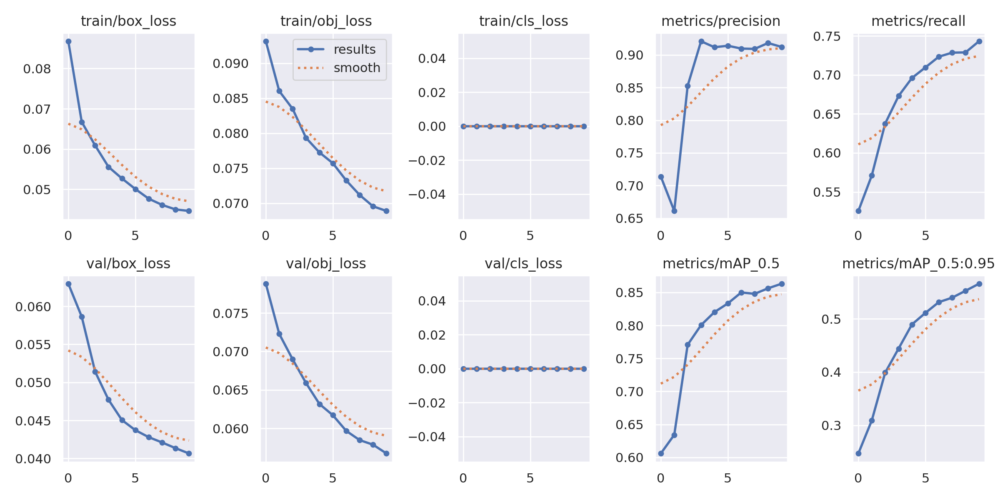

In [ ]:
from IPython.display import Image
Image(filename=f"{RES_DIR}/yolov5_mot17/results.png", width=800)

In [ ]:
!python val.py --weights {RES_DIR}/yolov5_mot17/weights/best.pt --data /content/drive/MyDrive/mot17_yolo/data.yaml --img 512 --iou 0.5

val: data=/content/drive/MyDrive/mot17_yolo/data.yaml, weights=['/content/drive/MyDrive/mot17_yolo/results_train/results_3/yolov5_mot17/weights/best.pt'], batch_size=32, imgsz=512, conf_thres=0.001, iou_thres=0.5, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-420-g0c99ce80 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/drive/MyDrive/mot17_yolo/val/labels.cache... 1064 images, 0 backgrounds, 0 corrupt: 100% 1064/1064 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 34/34 [00:30<00:00,  1.11it/s]
                   all       1064      22151      0.927       0.75      0.857      0.563
Speed: 0.1ms pre-process, 

### Run Inference on the Test Set

In [ ]:
!python detect.py \
  --weights {RES_DIR}/yolov5_mot17/weights/best.pt \
  --source /content/drive/MyDrive/mot17_yolo/test/images \
  --conf 0.25 \
  --save-txt \
  --save-conf \
  --project /content/drive/MyDrive/mot17_yolo \
  --name test_results

Streaming output truncated to the last 5000 lines.
image 926/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000476.jpg: 384x640 77 pedestrians, 7.5ms
image 927/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000477.jpg: 384x640 73 pedestrians, 7.6ms
image 928/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000478.jpg: 384x640 73 pedestrians, 7.5ms
image 929/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000479.jpg: 384x640 74 pedestrians, 7.5ms
image 930/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000480.jpg: 384x640 73 pedestrians, 7.7ms
image 931/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000481.jpg: 384x640 71 pedestrians, 8.4ms
image 932/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000482.jpg: 384x640 74 pedestrians, 10.6ms
image 933/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000483.jpg: 384x640 73 pedestrians, 8.3ms
imag

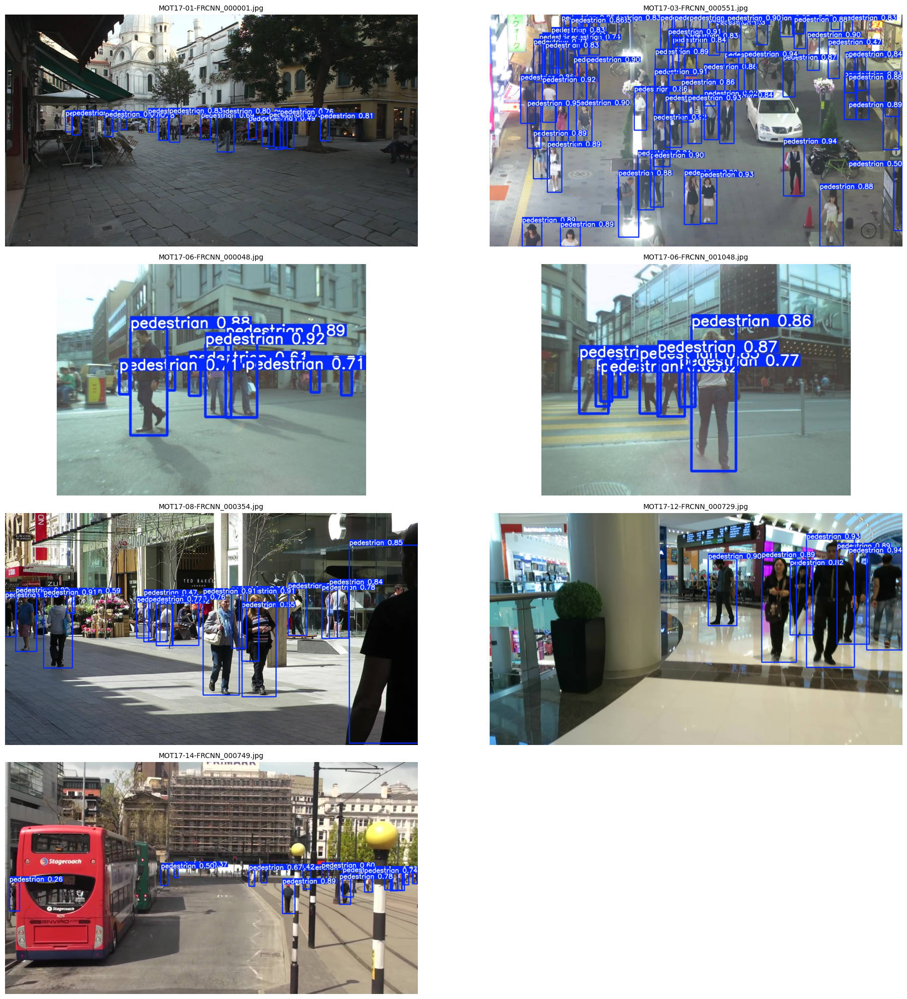

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Folder containing predicted images
pred_img_dir = "/content/drive/MyDrive/mot17_yolo/test_results"

# Get sorted .jpg files (to ensure indexing is valid)
pred_imgs = sorted([f for f in os.listdir(pred_img_dir) if f.endswith(".jpg")])

# Sample indices to show
indices = [0, 1000, 2000, 3000, 4000, 5000, 5920]

# Plot 2 rows, 3 columns
plt.figure(figsize=(20, 20))  # Wide figure

for i, idx in enumerate(indices):
    img_path = os.path.join(pred_img_dir, pred_imgs[idx])
    img = mpimg.imread(img_path)
    plt.subplot(4, 2, i + 1)
    plt.imshow(img)
    plt.title(pred_imgs[idx], fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Training YOLOv5m

In [ ]:
TRAIN = True

In [ ]:
def result_dir():

    base_path = '/content/drive/MyDrive/mot17_yolo/train_results_yolov5m'
    os.makedirs(base_path, exist_ok = True)

    res_dirs = glob(os.path.join(base_path,'results_*'))
    res_dir_count = len(res_dirs)

    if TRAIN:
      res_name = f"results_{res_dir_count + 1}"
    else:
      res_name = f"results_{res_dir_count}"

    res_path = os.path.join(base_path, res_name)
    print(f"Logging to: {res_path}")
    return res_path

In [ ]:
RES_DIR_med = result_dir()

Logging to: /content/drive/MyDrive/mot17_yolo/train_results_yolov5m/results_1


In [ ]:
RES_DIR_med = "/content/drive/MyDrive/mot17_yolo/train_results_yolov5m/results_1"

In [ ]:
!python train.py \
  --img 512  \
  --batch 16 \
  --epochs 10 \
  --workers 4 \
  --data /content/drive/MyDrive/mot17_yolo/data.yaml \
  --weights yolov5m.pt \
  --project {RES_DIR_med} \
  --name yolov5_mot17

Streaming output truncated to the last 5000 lines.
  with torch.cuda.amp.autocast(amp):
        0/9      3.92G    0.08479     0.0996          0        538        512:  71% 190/266 [02:30<00:50,  1.49it/s]/content/yolov5/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
        0/9      3.92G    0.08469    0.09961          0        714        512:  72% 191/266 [02:30<00:52,  1.43it/s]/content/yolov5/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
        0/9      3.92G     0.0846    0.09958          0        645        512:  72% 192/266 [02:31<00:50,  1.45it/s]/content/yolov5/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with tor

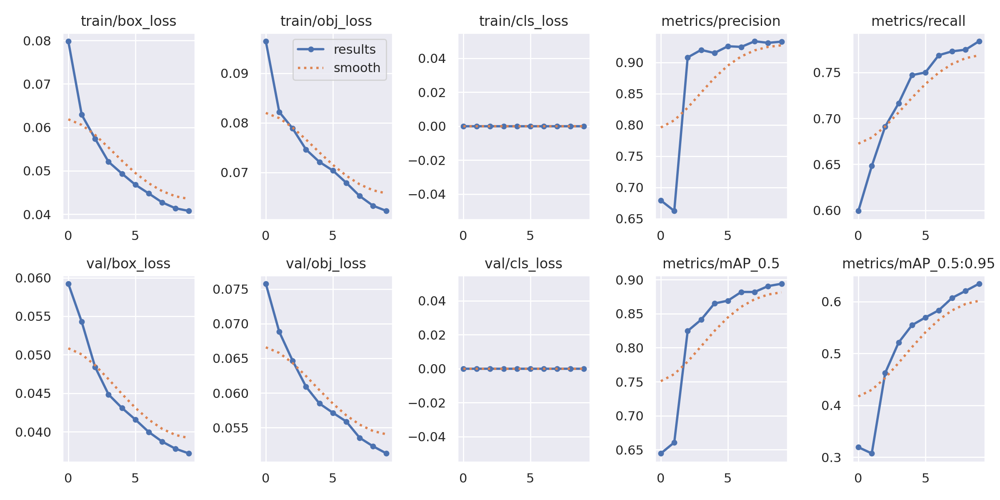

In [ ]:
from IPython.display import Image
Image(filename=f"{RES_DIR_med}/yolov5_mot17/results.png", width=800)

In [ ]:
!python val.py --weights {RES_DIR_med}/yolov5_mot17/weights/best.pt --data /content/drive/MyDrive/mot17_yolo/data.yaml --img 512 --iou 0.5

val: data=/content/drive/MyDrive/mot17_yolo/data.yaml, weights=['/content/drive/MyDrive/mot17_yolo/train_results_yolov5m/results_1/yolov5_mot17/weights/best.pt'], batch_size=32, imgsz=512, conf_thres=0.001, iou_thres=0.5, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-420-g0c99ce80 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)

Fusing layers... 
Model summary: 212 layers, 20852934 parameters, 0 gradients, 47.9 GFLOPs
val: Scanning /content/drive/MyDrive/mot17_yolo/val/labels.cache... 1064 images, 0 backgrounds, 0 corrupt: 100% 1064/1064 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 34/34 [00:35<00:00,  1.06s/it]
                   all       1064      22151      0.939      0.792      0.889      0.634
Speed: 0.1ms pre-

### Run Inference on the Test Set

In [ ]:
!python detect.py \
  --weights {RES_DIR_med}/yolov5_mot17/weights/best.pt \
  --source /content/drive/MyDrive/mot17_yolo/test/images \
  --conf 0.25 \
  --save-txt \
  --save-conf \
  --project /content/drive/MyDrive/mot17_yolo \
  --name test_results_m

Streaming output truncated to the last 5000 lines.
image 926/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000476.jpg: 384x640 71 pedestrians, 19.7ms
image 927/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000477.jpg: 384x640 73 pedestrians, 19.7ms
image 928/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000478.jpg: 384x640 73 pedestrians, 19.7ms
image 929/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000479.jpg: 384x640 71 pedestrians, 19.7ms
image 930/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000480.jpg: 384x640 70 pedestrians, 19.7ms
image 931/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000481.jpg: 384x640 71 pedestrians, 19.7ms
image 932/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000482.jpg: 384x640 71 pedestrians, 19.7ms
image 933/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000483.jpg: 384x640 73 pedestrians, 19.7

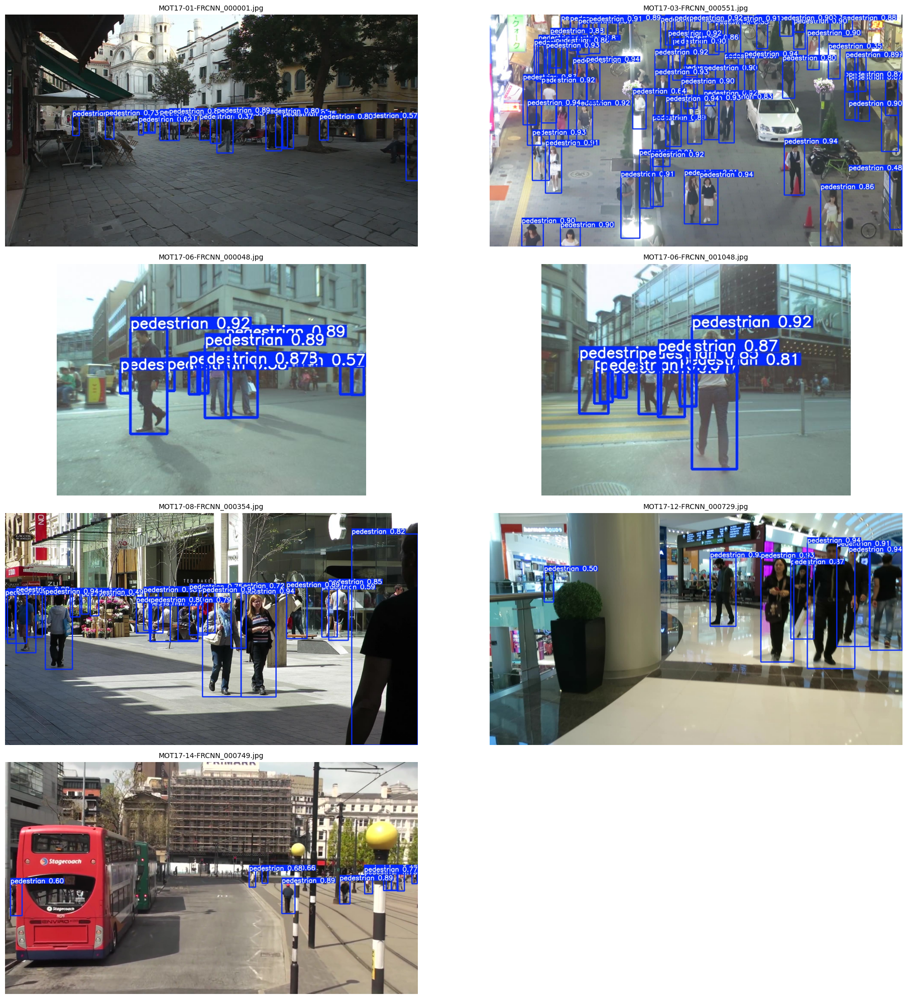

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Folder containing predicted images
pred_img_dir = "/content/drive/MyDrive/mot17_yolo/test_results_m"

# Get sorted .jpg files (to ensure indexing is valid)
pred_imgs = sorted([f for f in os.listdir(pred_img_dir) if f.endswith(".jpg")])

# Sample indices to show
indices = [0, 1000, 2000, 3000, 4000, 5000, 5920]

# Plot 2 rows, 3 columns
plt.figure(figsize=(20, 20))  # Wide figure

for i, idx in enumerate(indices):
    img_path = os.path.join(pred_img_dir, pred_imgs[idx])
    img = mpimg.imread(img_path)
    plt.subplot(4, 2, i + 1)
    plt.imshow(img)
    plt.title(pred_imgs[idx], fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Freezing some layers of YOLOv5m

In [ ]:
TRAIN = True

In [ ]:
def result_dir():

    base_path = '/content/drive/MyDrive/mot17_yolo/train_results_yolov5m_freeze'
    os.makedirs(base_path, exist_ok = True)

    res_dirs = glob(os.path.join(base_path,'results_*'))
    res_dir_count = len(res_dirs)

    if TRAIN:
      res_name = f"results_{res_dir_count + 1}"
    else:
      res_name = f"results_{res_dir_count}"

    res_path = os.path.join(base_path, res_name)
    print(f"Logging to: {res_path}")
    return res_path

In [ ]:
RES_DIR_med_frz = result_dir()

Logging to: /content/drive/MyDrive/mot17_yolo/train_results_yolov5m_freeze/results_1


In [ ]:
!python train.py \
  --img 512  \
  --batch 16 \
  --epochs 10 \
  --workers 8 \
  --data /content/drive/MyDrive/mot17_yolo/data.yaml \
  --weights yolov5m.pt \
  --project {RES_DIR_med_frz} \
  --name yolov5_mot17\
  --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Streaming output truncated to the last 5000 lines.
  with torch.cuda.amp.autocast(amp):
        0/9      1.35G     0.0889     0.1031          0        538        512:  71% 190/266 [02:31<00:45,  1.66it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
        0/9      1.35G    0.08881     0.1031          0        714        512:  72% 191/266 [02:32<00:55,  1.35it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
        0/9      1.35G    0.08873     0.1031          0        645        512:  72% 192/266 [02:32<00:43,  1.70it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(

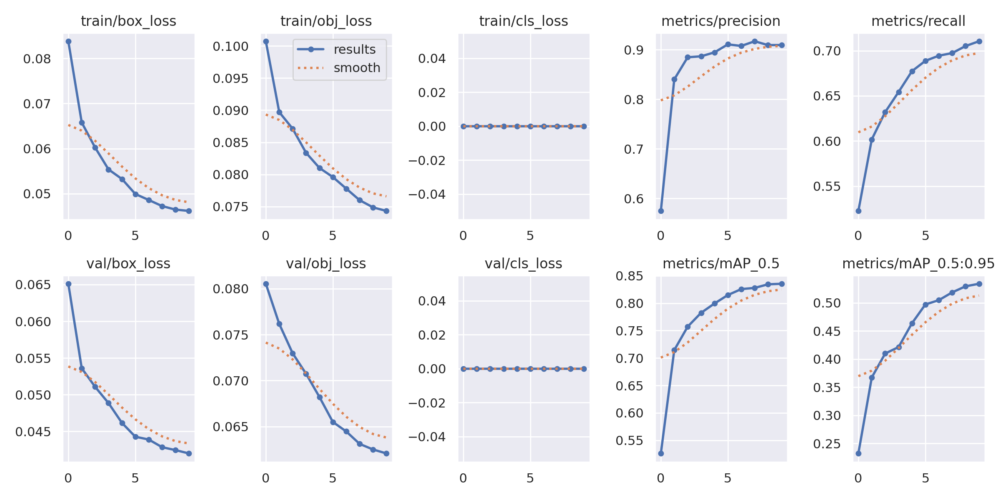

In [ ]:
from IPython.display import Image
Image(filename=f"{RES_DIR_med_frz}/yolov5_mot17/results.png", width=800)

In [ ]:
!python val.py --weights {RES_DIR_med_frz}/yolov5_mot17/weights/best.pt --data /content/drive/MyDrive/mot17_yolo/data.yaml --img 512 --iou 0.5

val: data=/content/drive/MyDrive/mot17_yolo/data.yaml, weights=['/content/drive/MyDrive/mot17_yolo/train_results_yolov5m_freeze/results_1/yolov5_mot17/weights/best.pt'], batch_size=32, imgsz=512, conf_thres=0.001, iou_thres=0.5, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-421-g79c4c31d Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)

Fusing layers... 
Model summary: 212 layers, 20852934 parameters, 0 gradients, 47.9 GFLOPs
val: Scanning /content/drive/MyDrive/mot17_yolo/val/labels.cache... 1064 images, 0 backgrounds, 0 corrupt: 100% 1064/1064 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 34/34 [00:35<00:00,  1.06s/it]
                   all       1064      22151      0.919      0.719      0.828      0.527
Speed: 0.1

### Inference on Test set

In [ ]:
!python detect.py \
  --weights {RES_DIR_med_frz}/yolov5_mot17/weights/best.pt \
  --source /content/drive/MyDrive/mot17_yolo/test/images \
  --conf 0.25 \
  --save-txt \
  --save-conf \
  --project /content/drive/MyDrive/mot17_yolo \
  --name test_results_m_frz

Streaming output truncated to the last 5000 lines.
image 926/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000476.jpg: 384x640 74 pedestrians, 19.7ms
image 927/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000477.jpg: 384x640 75 pedestrians, 19.7ms
image 928/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000478.jpg: 384x640 76 pedestrians, 19.7ms
image 929/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000479.jpg: 384x640 72 pedestrians, 19.7ms
image 930/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000480.jpg: 384x640 74 pedestrians, 19.7ms
image 931/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000481.jpg: 384x640 76 pedestrians, 19.6ms
image 932/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000482.jpg: 384x640 76 pedestrians, 19.7ms
image 933/5922 /content/drive/MyDrive/mot17_yolo/test/images/MOT17-03-FRCNN_000483.jpg: 384x640 74 pedestrians, 19.6

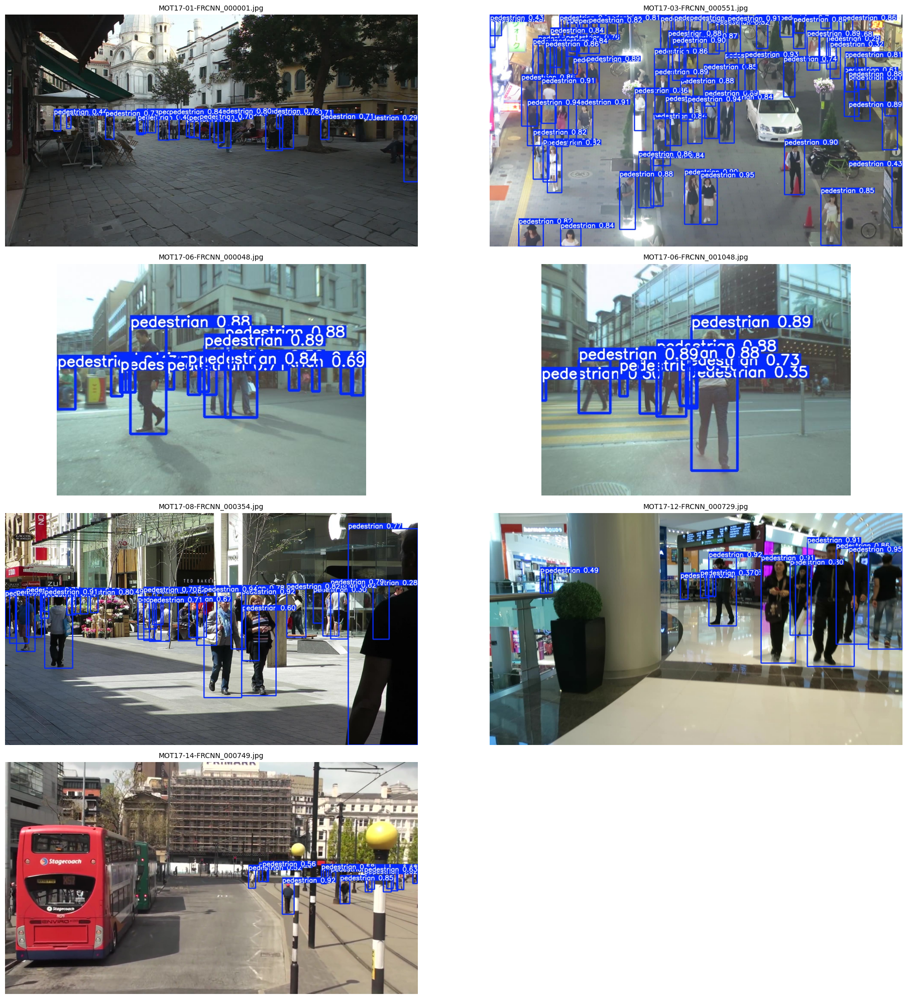

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Folder containing predicted images
pred_img_dir = "/content/drive/MyDrive/mot17_yolo/test_results_m_frz"

# Get sorted .jpg files (to ensure indexing is valid)
pred_imgs = sorted([f for f in os.listdir(pred_img_dir) if f.endswith(".jpg")])

# Sample indices to show
indices = [0, 1000, 2000, 3000, 4000, 5000, 5920]

# Plot 2 rows, 3 columns
plt.figure(figsize=(20, 20))  # Wide figure

for i, idx in enumerate(indices):
    img_path = os.path.join(pred_img_dir, pred_imgs[idx])
    img = mpimg.imread(img_path)
    plt.subplot(4, 2, i + 1)
    plt.imshow(img)
    plt.title(pred_imgs[idx], fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()

### Results on Validation set(1064 images):


| **Model**            | **Precision (P)** | **Recall (R)** | **mAP\@0.5** | **mAP\@0.5:0.95** |
| -------------------- | ----------------- | -------------- | ------------ | ----------------- |
| **YOLOv5s**          | 0.927             | 0.750          | 0.857        | 0.563             |
| **YOLOv5m**          | 0.939             | 0.792          | 0.889        | 0.634             |
| **YOLOv5m (frozen)** | 0.919             | 0.719          | 0.828        | 0.527             |



* **YOLOv5m** performs best overall in all metrics
* **YOLOv5m (frozen)** shows reduced performance, especially in recall and mAP, indicating that freezing layers limited its learning capacity
* **YOLOv5s**  has slightly lower performance than YOLOv5m





### Comparing the predictions of three models on a test image

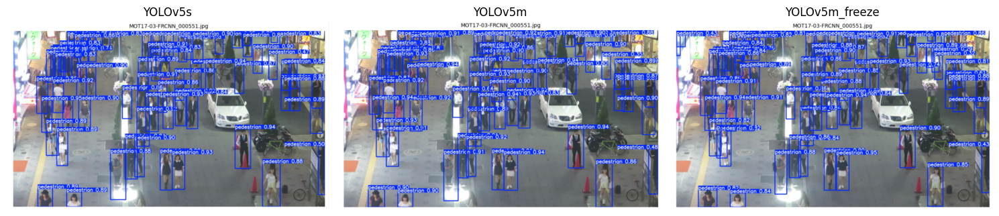

In [ ]:
import matplotlib.pyplot as plt
import cv2

# Load images
img1 = cv2.imread('/content/MOT17-03-FRCNN-000551_YOLOv5s.png')
img2 = cv2.imread('/content/MOT17-03-FRCNN-000551_YOLOv5m.png')
img3 = cv2.imread('/content/MOT17-03-FRCNN-000551_YOLOv5m_freeze.png')

# Convert BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
img3 = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(img1)
plt.title('YOLOv5s')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(img2)
plt.title('YOLOv5m')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(img3)
plt.title('YOLOv5m_freeze')
plt.axis('off')

plt.tight_layout()
plt.show()